In [4]:
import pandas as pd
import geopandas as gpd
import movingpandas as mpd
from datetime import timedelta, datetime
from shapely.geometry import Point
import matplotlib.pyplot as plt
from PIL import Image
df_july = pd.read_csv('2_7_2022_airport_test.csv')

In [5]:
df_july

,time,icao24,lat,lon,velocity,heading,vertrate,callsign,onground,alert,spi,squawk,baroaltitude,geoaltitude,lastposupdate,lastcontact,hour
0,1656735508,ad4395,40.87118892346398,-74.06670310280538,92.40107395780905,143.8319086509693,-0.32512,DAL2366,False,False,False,7256.0,601.98,609.6,1656735507.789,1656735507.979,1656734400
1,1656735512,ad4395,40.86827087402344,-74.06463623046875,89.03597505019947,153.5829996032664,0.0,DAL2366,False,False,False,7256.0,601.98,601.98,1656735511.726,1656735511.995,1656734400
2,1656735516,ad4395,40.86534118652344,-74.06341552734375,86.42812306977167,163.3987530128292,0.32512,DAL2366,False,False,False,7256.0,601.98,601.98,1656735515.715,1656735515.999,1656734400
3,1656735520,ad4395,40.8623439982786,-74.06270807439631,84.83491967771516,171.2802534937627,0.0,DAL2366,False,False,False,7256.0,601.98,601.98,1656735519.63,1656735519.999,1656734400
4,1656735524,ad4395,40.85936465505826,-74.06277049671519,82.4138645747565,182.8624052261117,-0.65024,DAL2366,False,False,False,7256.0,601.98,601.98,1656735523.622,1656735523.99,1656734400
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
52884,1656819352,4d20f8,40.82919880495233,-74.060585715554,80.26810235900635,181.1017061152064,15.60576,VJT895,False,False,False,7133.0,304.8,304.8,1656819351.967,1656819351.974,1656817200
52885,1656819356,4d20f8,40.82659187963453,-74.06077298251068,81.51624508247843,184.3432399516894,13.32992,VJT895,False,False,False,7133.0,358.14,350.52,1656819355.47,1656819355.941,1656817200
52886,1656819360,4d20f8,40.82341003417969,-74.06158447265625,83.60783392343788,194.9768359395421,10.72896,VJT895,False,False,False,7133.0,403.86,403.86,1656819359.738,1656819359.973,1656817200
52887,1656819364,4d20f8,40.82072629766949,-74.06326987526631,85.69624149223154,209.4889078122725,9.42848,VJT895,False,False,False,7133.0,441.96,441.96,1656819363.764,1656819363.918,1656817200


In [6]:
#convert date and time
def getDate(row):
    try:
        date = int(row['time'])
    except:
        date = None
        #print(row['time'])
    return date


df_july['seconds'] = df_july.apply(getDate, axis = 1)
df_july['datetime'] =  pd.to_datetime(df_july['seconds'], unit='s')

In [7]:
#correct data type for x,y,z coordinates
def getFilter(row):
    try:
        lat = float(row['lat'])
        return True
    except:
        return False
        
df_july['filter'] = df_july.apply(getFilter, axis = 1)

df2 = df_july[df_july['filter']].copy()
df2['y'] = df2['lat'].astype(float)
df2['x'] = df2['lon'].astype(float)
df2['z'] = df2['geoaltitude'].astype(float)

In [8]:
#create geo data frame
geom = gpd.points_from_xy(df2.x, df2.y)
gdf_july = gpd.GeoDataFrame(df2, geometry=geom, crs = 4326).to_crs(32118)
gdf_july = gdf_july[gdf_july['datetime'].between('2022-07-02','2022-07-03')]

In [9]:
#new t column for time for trajectory
gdf_july['t'] = pd.to_datetime(gdf_july['datetime'])
gdf_july['date'] = gdf_july['t']
#generate weekdays
gdf_july['weekday'] = gdf_july['t'].dt.strftime('%A')
gdf_july['weekday']

0        Saturday
1        Saturday
2        Saturday
3        Saturday
4        Saturday
           ...   
50075    Saturday
50076    Saturday
50077    Saturday
50078    Saturday
50079    Saturday
Name: weekday, Length: 50038, dtype: object

In [10]:
# get all icaos
top_icaos = list(gdf_july['icao24'].value_counts().index)
top_icaos 

['aa8548',
 'a4bd2a',
 'a4b205',
 'a4d45c',
 'ac1dbc',
 'a1ad1f',
 'a4c03c',
 'a9923b',
 'a1d49e',
 'a9ba85',
 'a5e880',
 'acb1f5',
 'a3b8e8',
 'ab151d',
 'a82128',
 'a6aa28',
 'a81624',
 'a0de49',
 'a81f62',
 'aa5a3b',
 'a6e05e',
 'a4d375',
 'aaaa70',
 'a53e8e',
 'a2c7f3',
 'a0c993',
 'a13bc1',
 'a69e14',
 'ab5017',
 'a703e8',
 'a47e31',
 'a1bc3b',
 'a13f8b',
 'a909da',
 'a9c1aa',
 'a1eeb7',
 'a4d979',
 'a1ed17',
 'a1d0e7',
 'a7113d',
 'ab432b',
 'a8fbf7',
 'a7ce97',
 'a05277',
 'ad4389',
 'c001eb',
 'acb60e',
 'a72734',
 'a120a1',
 'a69cf0',
 'a19bc9',
 'a700da',
 'a0fa8b',
 'a32b44',
 'a44443',
 'ab2883',
 'aadc2b',
 'ab3dd0',
 'a03f66',
 'a67928',
 'ad0d70',
 'ab6af3',
 'aa3d97',
 'a6a0f6',
 'ab3a19',
 'a952ae',
 'aadf38',
 'a99703',
 'a373a3',
 'aa7548',
 'a50757',
 'a708ef',
 'ac3238',
 '500255',
 'a63864',
 'ad61b8',
 'a155ad',
 'a98ed4',
 'a8e495',
 'a38252',
 'a6266d',
 'add150',
 'a68009',
 'a77147',
 'a84e07',
 'adabfd',
 'a206c9',
 'a33391',
 'a0cb44',
 'aae054',
 'a79556',

In [11]:
# generate trajectory lines based on each helicopter and give unique index to each trip they took
all_traj_lines = pd.DataFrame()

for icao24 in top_icaos:
    #get all rows that has the same icaos and make them into different gdf
    icao_df = gdf_july[gdf_july['icao24'] == icao24]
    #check if they are multisegments by using time, shift it first to calculate time differences
    shift_icao_df = icao_df['datetime'].shift(1,axis='rows')

    def getDifference(row):
        first_date = row['datetime']
        second_date = shift_icao_df[row.name]
        return first_date - second_date


    icao_df['Difference'] = icao_df.apply(getDifference, axis = 1)
    outlier_rows = icao_df[icao_df['Difference'].dt.seconds >= 60]
    #check if there are any entries to begin with
    icao_segments = []
    if len(outlier_rows) > 0:
        prev_index = 0
        for current_index in outlier_rows.index:
            segment = icao_df.loc[prev_index: current_index-1]
            icao_segments.append(segment)
            prev_index = current_index
        #after we exist the for loop we do the last bit
        segment = icao_df.loc[current_index-1: ]
        icao_segments.append(segment)
    else:
        icao_segments = [icao_df]
            
        
    for segment in icao_segments:
        segment = segment.set_index(['t'])
        #do traj for each dataframe
        traj_sub = mpd.Trajectory(segment, 1, t='t')
        traj_lines = traj_sub.to_line_gdf()
        all_traj_lines = pd.concat([all_traj_lines, traj_lines])

/opt/anaconda3/envs/movingpd/lib/python3.10/site-packages/geopandas/geodataframe.py:1456: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
/opt/anaconda3/envs/movingpd/lib/python3.10/site-packages/pandas/core/dtypes/cast.py:122: ShapelyDeprecationWarning: The array interface is deprecated and will no longer work in Shapely 2.0. Convert the '.coords' to a numpy array instead.
  arr = construct_1d_object_array_from_listlike(values)
/opt/anaconda3/envs/movingpd/lib/python3.10/site-packages/pandas/core/dtypes/cast.py:122: ShapelyDeprecationWarning: The array interface is deprecated and will no longer work in Shapely 2.0. Convert the '.coords' to a numpy array instead.
  arr = construct_1d_object_array_from_listlike(values

/opt/anaconda3/envs/movingpd/lib/python3.10/site-packages/pandas/core/dtypes/cast.py:122: ShapelyDeprecationWarning: The array interface is deprecated and will no longer work in Shapely 2.0. Convert the '.coords' to a numpy array instead.
  arr = construct_1d_object_array_from_listlike(values)
/opt/anaconda3/envs/movingpd/lib/python3.10/site-packages/pandas/core/dtypes/cast.py:122: ShapelyDeprecationWarning: The array interface is deprecated and will no longer work in Shapely 2.0. Convert the '.coords' to a numpy array instead.
  arr = construct_1d_object_array_from_listlike(values)
/opt/anaconda3/envs/movingpd/lib/python3.10/site-packages/pandas/core/dtypes/cast.py:122: ShapelyDeprecationWarning: The array interface is deprecated and will no longer work in Shapely 2.0. Convert the '.coords' to a numpy array instead.
  arr = construct_1d_object_array_from_listlike(values)
/opt/anaconda3/envs/movingpd/lib/python3.10/site-packages/pandas/core/dtypes/cast.py:122: ShapelyDeprecationWarning

/opt/anaconda3/envs/movingpd/lib/python3.10/site-packages/pandas/core/dtypes/cast.py:122: ShapelyDeprecationWarning: The array interface is deprecated and will no longer work in Shapely 2.0. Convert the '.coords' to a numpy array instead.
  arr = construct_1d_object_array_from_listlike(values)
/opt/anaconda3/envs/movingpd/lib/python3.10/site-packages/geopandas/geodataframe.py:1456: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
/opt/anaconda3/envs/movingpd/lib/python3.10/site-packages/pandas/core/dtypes/cast.py:122: ShapelyDeprecationWarning: The array interface is deprecated and will no longer work in Shapely 2.0. Convert the '.coords' to a numpy array instead.
  arr = construct_1d_object_array_from_listlike(values

/opt/anaconda3/envs/movingpd/lib/python3.10/site-packages/pandas/core/dtypes/cast.py:122: ShapelyDeprecationWarning: The array interface is deprecated and will no longer work in Shapely 2.0. Convert the '.coords' to a numpy array instead.
  arr = construct_1d_object_array_from_listlike(values)
/opt/anaconda3/envs/movingpd/lib/python3.10/site-packages/pandas/core/dtypes/cast.py:122: ShapelyDeprecationWarning: The array interface is deprecated and will no longer work in Shapely 2.0. Convert the '.coords' to a numpy array instead.
  arr = construct_1d_object_array_from_listlike(values)
/opt/anaconda3/envs/movingpd/lib/python3.10/site-packages/geopandas/geodataframe.py:1456: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value

/opt/anaconda3/envs/movingpd/lib/python3.10/site-packages/pandas/core/dtypes/cast.py:122: ShapelyDeprecationWarning: The array interface is deprecated and will no longer work in Shapely 2.0. Convert the '.coords' to a numpy array instead.
  arr = construct_1d_object_array_from_listlike(values)
/opt/anaconda3/envs/movingpd/lib/python3.10/site-packages/pandas/core/dtypes/cast.py:122: ShapelyDeprecationWarning: The array interface is deprecated and will no longer work in Shapely 2.0. Convert the '.coords' to a numpy array instead.
  arr = construct_1d_object_array_from_listlike(values)
/opt/anaconda3/envs/movingpd/lib/python3.10/site-packages/pandas/core/dtypes/cast.py:122: ShapelyDeprecationWarning: The array interface is deprecated and will no longer work in Shapely 2.0. Convert the '.coords' to a numpy array instead.
  arr = construct_1d_object_array_from_listlike(values)
/opt/anaconda3/envs/movingpd/lib/python3.10/site-packages/geopandas/geodataframe.py:1456: SettingWithCopyWarning: 


/opt/anaconda3/envs/movingpd/lib/python3.10/site-packages/pandas/core/dtypes/cast.py:122: ShapelyDeprecationWarning: The array interface is deprecated and will no longer work in Shapely 2.0. Convert the '.coords' to a numpy array instead.
  arr = construct_1d_object_array_from_listlike(values)
/opt/anaconda3/envs/movingpd/lib/python3.10/site-packages/pandas/core/dtypes/cast.py:122: ShapelyDeprecationWarning: The array interface is deprecated and will no longer work in Shapely 2.0. Convert the '.coords' to a numpy array instead.
  arr = construct_1d_object_array_from_listlike(values)
/opt/anaconda3/envs/movingpd/lib/python3.10/site-packages/geopandas/geodataframe.py:1456: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value

/opt/anaconda3/envs/movingpd/lib/python3.10/site-packages/pandas/core/dtypes/cast.py:122: ShapelyDeprecationWarning: The array interface is deprecated and will no longer work in Shapely 2.0. Convert the '.coords' to a numpy array instead.
  arr = construct_1d_object_array_from_listlike(values)
/opt/anaconda3/envs/movingpd/lib/python3.10/site-packages/geopandas/geodataframe.py:1456: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
/opt/anaconda3/envs/movingpd/lib/python3.10/site-packages/pandas/core/dtypes/cast.py:122: ShapelyDeprecationWarning: The array interface is deprecated and will no longer work in Shapely 2.0. Convert the '.coords' to a numpy array instead.
  arr = construct_1d_object_array_from_listlike(values

/opt/anaconda3/envs/movingpd/lib/python3.10/site-packages/pandas/core/dtypes/cast.py:122: ShapelyDeprecationWarning: The array interface is deprecated and will no longer work in Shapely 2.0. Convert the '.coords' to a numpy array instead.
  arr = construct_1d_object_array_from_listlike(values)
/opt/anaconda3/envs/movingpd/lib/python3.10/site-packages/geopandas/geodataframe.py:1456: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
/opt/anaconda3/envs/movingpd/lib/python3.10/site-packages/pandas/core/dtypes/cast.py:122: ShapelyDeprecationWarning: The array interface is deprecated and will no longer work in Shapely 2.0. Convert the '.coords' to a numpy array instead.
  arr = construct_1d_object_array_from_listlike(values

ValueError: The input DataFrame must have at least two rows.

In [14]:
all_traj_lines

,time,icao24,lat,lon,velocity,heading,vertrate,callsign,onground,alert,...,filter,y,x,z,date,weekday,Difference,t,prev_t,geometry
0,1656767888,aa8548,40.79612731933594,-74.06396484375,65.34248897808446,130.2098692776368,0,N777ZA,false,false,...,True,40.796127,-74.063965,220.98,2022-07-02 13:18:08,Saturday,0 days 00:00:04,2022-07-02 13:18:08,2022-07-02 13:18:04,"LINESTRING (294421.581 70048.750, 294601.754 6..."
1,1656767892,aa8548,40.79443359375,-74.06134033203125,65.28576102210405,130.8461469130488,0.65024,N777ZA,false,false,...,True,40.794434,-74.061340,228.60,2022-07-02 13:18:12,Saturday,0 days 00:00:04,2022-07-02 13:18:12,2022-07-02 13:18:08,"LINESTRING (294601.754 69901.198, 294823.114 6..."
2,1656767896,aa8548,40.79292297363281,-74.05908203125,65.96327671989147,131.5222134802018,0,N777ZA,false,false,...,True,40.792923,-74.059082,228.60,2022-07-02 13:18:16,Saturday,0 days 00:00:04,2022-07-02 13:18:16,2022-07-02 13:18:12,"LINESTRING (294823.114 69712.953, 295013.592 6..."
3,1656767900,aa8548,40.79163114903336,-74.05721491033381,65.92314330371586,132.1533830841839,-0.65024,N777ZA,false,false,...,True,40.791631,-74.057215,228.60,2022-07-02 13:18:20,Saturday,0 days 00:00:04,2022-07-02 13:18:20,2022-07-02 13:18:16,"LINESTRING (295013.592 69545.070, 295171.079 6..."
4,1656767904,aa8548,40.78990173339844,-74.05474853515625,65.86691543883354,133.4176460773814,0,N777ZA,false,false,...,True,40.789902,-74.054749,228.60,2022-07-02 13:18:24,Saturday,0 days 00:00:04,2022-07-02 13:18:24,2022-07-02 13:18:20,"LINESTRING (295171.079 69401.509, 295379.119 6..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
85,1656776524,ab3a19,40.86213684082031,-74.05865478515625,60.81111071931944,183.3949235421182,-3.90144,GAJ822,false,false,...,True,40.862137,-74.058655,22.86,2022-07-02 15:42:04,Saturday,0 days 00:00:04,2022-07-02 15:42:04,2022-07-02 15:42:00,"LINESTRING (295054.797 77231.232, 295054.797 7..."
86,1656776528,ab3a19,40.86213684082031,-74.05865478515625,60.81111071931944,183.3949235421182,-3.90144,GAJ822,false,false,...,True,40.862137,-74.058655,22.86,2022-07-02 15:42:08,Saturday,0 days 00:00:04,2022-07-02 15:42:08,2022-07-02 15:42:04,"LINESTRING (295054.797 77231.232, 295054.797 7..."
87,1656776532,ab3a19,40.86213684082031,-74.05865478515625,60.81111071931944,183.3949235421182,-3.90144,GAJ822,false,false,...,True,40.862137,-74.058655,22.86,2022-07-02 15:42:12,Saturday,0 days 00:00:04,2022-07-02 15:42:12,2022-07-02 15:42:08,"LINESTRING (295054.797 77231.232, 295054.797 7..."
88,1656776536,ab3a19,40.86213684082031,-74.05865478515625,60.81111071931944,183.3949235421182,-3.90144,GAJ822,false,false,...,True,40.862137,-74.058655,22.86,2022-07-02 15:42:16,Saturday,0 days 00:00:04,2022-07-02 15:42:16,2022-07-02 15:42:12,"LINESTRING (295054.797 77231.232, 295054.797 7..."


In [16]:
#quickly draw all the lines (don't run this if you don't want to see approximatly how the lines look like, it takes a long time and is ugly)
all_traj_lines[['icao24','geoaltitude','geometry']].explore('icao24',tiles="CartoDB positron")

In [12]:
# define airprts (sights) and generate buffer of 700 meters, show on map to see
airport = {
  "type": "FeatureCollection",
  "features": [
    {
      "type": "Feature",
      "properties": {
        "airports": "Central Park"
      },
      "geometry": {
        "type": "Point",
        "coordinates": [
          -73.96459579467773,
          40.78349852250554
        ]
      }
    },
    {
      "type": "Feature",
      "properties": {
        "airports": "34 east"
      },
      "geometry": {
        "type": "Point",
        "coordinates": [
          -73.9720630645752,
          40.742355522334186
        ]
      }
    },
    {
      "type": "Feature",
      "properties": {
        "airports": "lower m"
      },
      "geometry": {
        "type": "Point",
        "coordinates": [
          -74.00870203971863,
          40.70104878257842
        ]
      }
    },
    {
      "type": "Feature",
      "properties": {
        "airports": "Hudson Yards"
      },
      "geometry": {
        "type": "Point",
        "coordinates": [
          -74.00710076093674,
          40.75494369347609
        ]
      }
    },
    {
      "type": "Feature",
      "properties": {
          "airports":"Statue of Liberty"
      },
      "geometry": {
        "type": "Point",
        "coordinates": [
          -74.04452140308526,
          40.68927037551208
        ]
      }
    }
  ]
}

airport = gpd.GeoDataFrame.from_features(airport, crs = 4326).to_crs(32118)
_map = airport.buffer(700).explore()

2022-07-02 13:15:00 0:30:00


IndexError: list index out of range

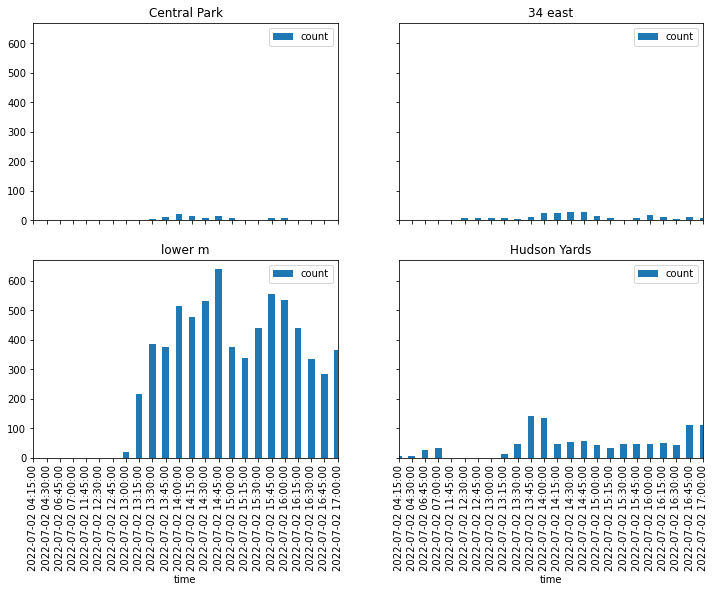

In [15]:
# define figures

fig, axs = plt.subplots(2, 2, sharex=True, sharey= True, figsize=(12,8))

lookup_axs = [
    axs[0][0],
    axs[0][1],
    axs[1][0],
    axs[1][1]
]

# count helicopter volumes
interval = "15min"
bins = all_traj_lines["date"].dt.floor(interval).unique()
print(pd.Timestamp(bins[0]), timedelta(minutes = 30))

    
for i, port in airport.iterrows():
    buffer = port.geometry.buffer(700)
    traj_in_buffer = all_traj_lines[all_traj_lines.intersects(buffer)]
    
    count = []
    for grouped_bin in bins:
        # subset the dataframe in the binned intervals
        subset = traj_in_buffer[traj_in_buffer['date'].between(
            pd.Timestamp(grouped_bin) - timedelta(minutes = 15), 
            pd.Timestamp(grouped_bin) + timedelta(minutes = 15)
        )]
        count.append({
        'time': pd.Timestamp(grouped_bin),
        'count': len(subset)
    })
    count_df =   pd.DataFrame(count).sort_values('time')
    count_df.to_csv(f'{port["airports"]}.csv', index = False)
    
    count_df.plot.bar(x='time', y='count', ax = lookup_axs[i])
    lookup_axs[i].set_title(port['airports'])
    lookup_axs[i].set_xlim([0,23])